## Importación de librerías

In [1]:
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)
import os
import tempfile
import numpy as npñ
import pandas as pd
import csv
import string
import json
import tensorflow as tf
import pickle
import copy

import operator
import math

import matplotlib.pyplot as plt
import seaborn as sns

#Import Document Set
from gensim import corpora, models, similarities
#from gensim.models.phrases import Phrases, Phraser
from gensim.models import Doc2Vec
from gensim.models.doc2vec import TaggedDocument

import nltk
from nltk.util import ngrams
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize

C:\Users\Victor\Anaconda3\envs\tensorflowCPU\lib\site-packages\gensim\utils.py:1209: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")
2019-02-13 11:10:33,097 : INFO : 'pattern' package not found; tag filters are not available for English


## Preprocesamiento

In [2]:
#Read a json file
def open_file(fname):
    with open(fname) as jsonfile:
            resumes = json.load(jsonfile)
    return resumes

In [3]:
def create_arr_by_skills(resumes):
    df=pd.DataFrame(resumes)
    job_desc=[]
    c=0
    for cv in df.Resume:
        puesto=cv["job"].lower()
    #     print(puesto)
        skill=""
        for skills in cv['skills_endorsment']:
            skill=skill+" "+skills['skill_name'].replace(" ","_")
        skill=skill.lower()
    #     print(skill)
    #         cat=skills['skill_category']
        if len(skill)>0:
            job_desc.append([puesto,skill])
            c=c+1
    print("Total CV's processed: {}".format(len(df.Resume)))
    print("Total CV's saved: {}".format(c))
    return job_desc   

# Jobs labeling Funtion 
def label_jobs(temp_file,job_desc):
    f= open(temp_file,"w+")
    jobs_labeled=[]
    documents=[]

    for job in job_desc:
        #Jobs Labeling
        if job[0].find("vice president")!= -1 or job[0].find("delivery manager")!= -1 or job[0].find(" vp ")!= -1 or job[0].find("svp ")!= -1:
            f.write("{} \t|\t vice president or equivalent\n".format(job[0]))
            label="vice president or equivalent"
        else :
            if job[0].find("president")!= -1:
                    f.write("{} \t|\t president or equivalent\n".format(job[0])) 
                    label="president or equivalent"
            else:            
                if job[0].find("director")!= -1:
                    f.write("{} \t|\t director or equivalent\n".format(job[0]))
                    label="director or equivalent"
                else:
                    if job[0].replace("sr","senior").find("senior project manager")!= -1 or (job[0].replace("sr","senior").find("senior")!= -1
                            and job[0].find("project manager")!= -1) or ( job[0].replace("programme","program").find("program")!= -1 and job[0].find("manager")!= -1):
                            f.write("{} \t|\t senior project manager or equivalent\n".format(job[0].replace("|",",")))
                            label="senior project manager or equivalent"
                    else:
                        if job[0].find("project manager")!= -1 or (job[0].find("project")!= -1 and job[0].replace("management","manager").find("manager")!= -1) or job[0].find("project coordinator")!= -1 or job[0].find("project consultant")!= -1 or (
                            job[0].find("manager")!= -1 ):
                            f.write("{} \t|\t project manager or equivalent\n".format(job[0].replace("|",",")))
                            label="project manager or equivalent"
                        else:
                            if job[0].find("leader")!= -1 or job[0].find("lead")!= -1:
                                f.write("{} \t|\t project leader or equivalent\n".format(job[0].replace("|",",")))
                                label="project leader or equivalent"
                            else:
                                if job[0].replace("sr","senior").find("senior")!= -1 or (job[0].find("technology")!= -1 and job[0].find("analyst")!= -1):
                                    f.write("{} \t|\t senior consultant or equivalent\n".format(job[0].replace("|",",")))
                                    label="senior consultant or equivalent"
                                else:
                                    if job[0].find("develop")!= -1 or job[0].find("system")!= -1 or job[0].find("tech")!= -1 or  job[0].find("analyst")!= -1 or  job[0].find("software")!= -1 or  job[0].find("it")!= -1 or  job[0].find("oracle")!= -1 or  job[0].find("consultant")!= -1 or  job[0].replace("jr","junior").find("junior")!= -1 or  job[0].find("engineer")!= -1:
                                        f.write("{} \t|\t it consultant or equivalent\n".format(job[0].replace("|",",")))
                                        label="it consultant or equivalent"
                                    else:
                                        f.write("{} \t|\t OOB\n".format(job[0].replace("|",",")))
                                        label="OOB"

        jobs_labeled.append([label,job[0],job[1].replace("\\n","\n").replace("   "," ").replace("  "," ").lower()])
    f.close()
    print("Archivo temporal creado en: {}".format(os.getcwd()))
    return documents,jobs_labeled

In [4]:
# Definition of the paths to be used
fpath= os.getcwd()
fname= 'C:\\Users\\Victor\\Documents\\LinkedIn Input/LinkedinCV(300)_2.json'
fmodelname = os.path.join(fpath,'Model/Doc2vecForSkill.model')
temp_file='JobsLabeledSk.txt'

In [5]:
resumes = open_file(fname)
job_desc = create_arr_by_skills(resumes)
_,jobs_labeled = label_jobs(temp_file,job_desc)

Total CV's processed: 300
Total CV's saved: 293
Archivo temporal creado en: C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding


In [50]:
#Sentence tokenization 
def token_separation(sDescription="",bSentence=False,bStopwords=False):
    
    sentenceTkn = []
    
    #Use of stopwords
    stoplist = []
    if stopwords:
        stoplist = list(set(stopwords.words('english')))
        stoplist.extend(["–","/","&",".","$","(",")","!","?",";",":","'",","])
    
    #Convert Description to sentence and Tokenization of words
    tnzr = nltk.tokenize
    if bSentence:
        sentences= sDescription.split(" ")
        for sen in sentences:
            tnkstr= tnzr.word_tokenize(sen)
            lSenTkn=[word for word in tnkstr if (word not in stoplist)]
            if len(lSenTkn)>0:
                sentenceTkn.append(lSenTkn)
    else:
        sentences = sDescription
        tnkstr= tnzr.word_tokenize(sentences)   
        sentenceTkn = [word for word in tnkstr if (word not in stoplist)]

    return sentenceTkn


In [51]:
jobs_labeled[0]

['project manager or equivalent',
 'project manager',
 ' python c++ opengl computer_vision algorithms computer_science machine_learning data_analysis data_visualization software_design science computer_graphics 3d_visualization big_data object_oriented_design shell_scripting web_services climate_change web_development proposal_writing social_media java javascript jquery_ui jquery android high_performance_computing parallel_computing vtk scientific_computing cmake mpi qt virtual_reality opengl_es data_science geoprocessing geovisualization paraview gdal webgl geographic_information_science scientific_data_management data_analytics big_data_analytics unix_shell_scripting']

In [52]:
 token_separation(jobs_labeled[0][2],bSentence=True,bStopwords=True)

[['python'],
 ['c++'],
 ['opengl'],
 ['computer_vision'],
 ['algorithms'],
 ['computer_science'],
 ['machine_learning'],
 ['data_analysis'],
 ['data_visualization'],
 ['software_design'],
 ['science'],
 ['computer_graphics'],
 ['3d_visualization'],
 ['big_data'],
 ['object_oriented_design'],
 ['shell_scripting'],
 ['web_services'],
 ['climate_change'],
 ['web_development'],
 ['proposal_writing'],
 ['social_media'],
 ['java'],
 ['javascript'],
 ['jquery_ui'],
 ['jquery'],
 ['android'],
 ['high_performance_computing'],
 ['parallel_computing'],
 ['vtk'],
 ['scientific_computing'],
 ['cmake'],
 ['mpi'],
 ['qt'],
 ['virtual_reality'],
 ['opengl_es'],
 ['data_science'],
 ['geoprocessing'],
 ['geovisualization'],
 ['paraview'],
 ['gdal'],
 ['webgl'],
 ['geographic_information_science'],
 ['scientific_data_management'],
 ['data_analytics'],
 ['big_data_analytics'],
 ['unix_shell_scripting']]

## Creación de tagged documents

In [53]:
#Tagged Documents
jobSentnc_tkn = []
documents = []
for d in jobs_labeled:
    jobSentnc_tkn.append([d[0],d[1],token_separation(d[2],bSentence=True,bStopwords=True)])
    documents.append(TaggedDocument(token_separation(d[2],bStopwords=True),[d[0].replace(" ","_")]))

In [54]:
jobSentnc_tkn[0]

['project manager or equivalent',
 'project manager',
 [['python'],
  ['c++'],
  ['opengl'],
  ['computer_vision'],
  ['algorithms'],
  ['computer_science'],
  ['machine_learning'],
  ['data_analysis'],
  ['data_visualization'],
  ['software_design'],
  ['science'],
  ['computer_graphics'],
  ['3d_visualization'],
  ['big_data'],
  ['object_oriented_design'],
  ['shell_scripting'],
  ['web_services'],
  ['climate_change'],
  ['web_development'],
  ['proposal_writing'],
  ['social_media'],
  ['java'],
  ['javascript'],
  ['jquery_ui'],
  ['jquery'],
  ['android'],
  ['high_performance_computing'],
  ['parallel_computing'],
  ['vtk'],
  ['scientific_computing'],
  ['cmake'],
  ['mpi'],
  ['qt'],
  ['virtual_reality'],
  ['opengl_es'],
  ['data_science'],
  ['geoprocessing'],
  ['geovisualization'],
  ['paraview'],
  ['gdal'],
  ['webgl'],
  ['geographic_information_science'],
  ['scientific_data_management'],
  ['data_analytics'],
  ['big_data_analytics'],
  ['unix_shell_scripting']]]

In [55]:
documents

[TaggedDocument(words=['python', 'c++', 'opengl', 'computer_vision', 'algorithms', 'computer_science', 'machine_learning', 'data_analysis', 'data_visualization', 'software_design', 'science', 'computer_graphics', '3d_visualization', 'big_data', 'object_oriented_design', 'shell_scripting', 'web_services', 'climate_change', 'web_development', 'proposal_writing', 'social_media', 'java', 'javascript', 'jquery_ui', 'jquery', 'android', 'high_performance_computing', 'parallel_computing', 'vtk', 'scientific_computing', 'cmake', 'mpi', 'qt', 'virtual_reality', 'opengl_es', 'data_science', 'geoprocessing', 'geovisualization', 'paraview', 'gdal', 'webgl', 'geographic_information_science', 'scientific_data_management', 'data_analytics', 'big_data_analytics', 'unix_shell_scripting'], tags=['project_manager_or_equivalent']),
 TaggedDocument(words=['troubleshooting', 'security', 'software_installation', 'electronics', 'testing', 'technical_support', 'software_documentation', 'maintenance_', '_repair

# Definición y Entrenamiento del modelo

## Hiperparametros

In [56]:
mDistMem = 0              # {0:"Distributed Bag of Words PV-DBOW",1:"Distributed Memory PV-DM"}
mAlphaM= 0.025            # Initial Learning rate
mEmbeddingDim = 200       # Dimnesionality of the feature vectors
mWindow= 10               # Maximum distance between the current and the predicted word 
mMinAlpha = 0.02          # Learning rate will linearly drop to min alpha  as training progresses
mMinCount = 1             # Ignores all words with total frecuency lower than this

## Definición del modelo

In [13]:
# Model definition 
model = models.Doc2Vec(documents, dm = mDistMem, alpha=mAlphaM, vector_size= mEmbeddingDim,window=mWindow, min_alpha=mMinAlpha, min_count=mMinCount)

2019-02-13 11:11:00,818 : INFO : collecting all words and their counts
2019-02-13 11:11:00,819 : INFO : PROGRESS: at example #0, processed 0 words (0/s), 0 word types, 0 tags
2019-02-13 11:11:00,822 : INFO : collected 2384 word types and 9 unique tags from a corpus of 293 examples and 9552 words
2019-02-13 11:11:00,823 : INFO : Loading a fresh vocabulary
2019-02-13 11:11:00,827 : INFO : effective_min_count=1 retains 2384 unique words (100% of original 2384, drops 0)
2019-02-13 11:11:00,828 : INFO : effective_min_count=1 leaves 9552 word corpus (100% of original 9552, drops 0)
2019-02-13 11:11:00,834 : INFO : deleting the raw counts dictionary of 2384 items
2019-02-13 11:11:00,836 : INFO : sample=0.001 downsamples 72 most-common words
2019-02-13 11:11:00,837 : INFO : downsampling leaves estimated 8153 word corpus (85.4% of prior 9552)
2019-02-13 11:11:00,842 : INFO : estimated required memory for 2384 words and 200 dimensions: 5015400 bytes
2019-02-13 11:11:00,843 : INFO : resetting lay

## Training

In [14]:
model.train(documents,total_examples=len(documents),epochs=500)

2019-02-13 11:11:05,566 : INFO : training model with 3 workers on 2384 vocabulary and 200 features, using sg=1 hs=0 sample=0.001 negative=5 window=10
2019-02-13 11:11:05,570 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:05,571 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:05,586 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:05,587 : INFO : EPOCH - 1 : training on 9552 raw words (8404 effective words) took 0.0s, 466764 effective words/s
2019-02-13 11:11:05,590 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:05,591 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:05,608 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:05,608 : INFO : EPOCH - 2 : training on 9552 raw words (8477 effective words) took 0.0s, 449610 effective words/s
2019-02-13 11:11:05,611 : INFO : worker th

2019-02-13 11:11:06,007 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,008 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:06,023 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,024 : INFO : EPOCH - 21 : training on 9552 raw words (8430 effective words) took 0.0s, 474312 effective words/s
2019-02-13 11:11:06,028 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,029 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:06,044 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,045 : INFO : EPOCH - 22 : training on 9552 raw words (8427 effective words) took 0.0s, 460643 effective words/s
2019-02-13 11:11:06,049 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,050 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-

2019-02-13 11:11:06,449 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,449 : INFO : EPOCH - 41 : training on 9552 raw words (8477 effective words) took 0.0s, 420082 effective words/s
2019-02-13 11:11:06,453 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,454 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:06,471 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,472 : INFO : EPOCH - 42 : training on 9552 raw words (8417 effective words) took 0.0s, 419157 effective words/s
2019-02-13 11:11:06,476 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,477 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:06,493 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,494 : INFO : EPOCH - 43 : training on 9552 raw words (8445 effective words) too

2019-02-13 11:11:06,897 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,898 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:06,914 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,914 : INFO : EPOCH - 62 : training on 9552 raw words (8400 effective words) took 0.0s, 462278 effective words/s
2019-02-13 11:11:06,919 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,920 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:06,944 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:06,945 : INFO : EPOCH - 63 : training on 9552 raw words (8429 effective words) took 0.0s, 307450 effective words/s
2019-02-13 11:11:06,948 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:06,948 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-

2019-02-13 11:11:07,345 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:07,346 : INFO : EPOCH - 82 : training on 9552 raw words (8502 effective words) took 0.0s, 444303 effective words/s
2019-02-13 11:11:07,349 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:07,350 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:07,365 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:07,366 : INFO : EPOCH - 83 : training on 9552 raw words (8429 effective words) took 0.0s, 480671 effective words/s
2019-02-13 11:11:07,370 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:07,371 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:07,386 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:07,387 : INFO : EPOCH - 84 : training on 9552 raw words (8435 effective words) too

2019-02-13 11:11:07,769 : INFO : EPOCH - 102 : training on 9552 raw words (8414 effective words) took 0.0s, 458916 effective words/s
2019-02-13 11:11:07,772 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:07,773 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:07,788 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:07,789 : INFO : EPOCH - 103 : training on 9552 raw words (8460 effective words) took 0.0s, 483310 effective words/s
2019-02-13 11:11:07,792 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:07,793 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:07,810 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:07,810 : INFO : EPOCH - 104 : training on 9552 raw words (8465 effective words) took 0.0s, 458447 effective words/s
2019-02-13 11:11:07,813 : INFO : worker thread finished

2019-02-13 11:11:08,191 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:08,192 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:08,209 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:08,209 : INFO : EPOCH - 123 : training on 9552 raw words (8385 effective words) took 0.0s, 436585 effective words/s
2019-02-13 11:11:08,213 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:08,215 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:08,229 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:08,230 : INFO : EPOCH - 124 : training on 9552 raw words (8469 effective words) took 0.0s, 484491 effective words/s
2019-02-13 11:11:08,233 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:08,234 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-0

2019-02-13 11:11:09,041 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,056 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,057 : INFO : EPOCH - 163 : training on 9552 raw words (8451 effective words) took 0.0s, 467961 effective words/s
2019-02-13 11:11:09,060 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:09,061 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,076 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,077 : INFO : EPOCH - 164 : training on 9552 raw words (8427 effective words) took 0.0s, 506756 effective words/s
2019-02-13 11:11:09,080 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:09,081 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,097 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-0

2019-02-13 11:11:09,474 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,475 : INFO : EPOCH - 183 : training on 9552 raw words (8432 effective words) took 0.0s, 462202 effective words/s
2019-02-13 11:11:09,478 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:09,479 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,495 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,496 : INFO : EPOCH - 184 : training on 9552 raw words (8407 effective words) took 0.0s, 448357 effective words/s
2019-02-13 11:11:09,499 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:09,500 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,515 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,516 : INFO : EPOCH - 185 : training on 9552 raw words (8407 effective words) 

2019-02-13 11:11:09,889 : INFO : EPOCH - 203 : training on 9552 raw words (8461 effective words) took 0.0s, 458407 effective words/s
2019-02-13 11:11:09,893 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:09,893 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,909 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,909 : INFO : EPOCH - 204 : training on 9552 raw words (8457 effective words) took 0.0s, 486032 effective words/s
2019-02-13 11:11:09,913 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:09,914 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:09,930 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:09,930 : INFO : EPOCH - 205 : training on 9552 raw words (8448 effective words) took 0.0s, 481365 effective words/s
2019-02-13 11:11:09,933 : INFO : worker thread finished

2019-02-13 11:11:10,309 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:10,310 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:10,326 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:10,327 : INFO : EPOCH - 224 : training on 9552 raw words (8453 effective words) took 0.0s, 448254 effective words/s
2019-02-13 11:11:10,330 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:10,331 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:10,347 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:10,348 : INFO : EPOCH - 225 : training on 9552 raw words (8481 effective words) took 0.0s, 458673 effective words/s
2019-02-13 11:11:10,351 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:10,352 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-0

2019-02-13 11:11:10,723 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:10,739 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:10,740 : INFO : EPOCH - 244 : training on 9552 raw words (8485 effective words) took 0.0s, 468048 effective words/s
2019-02-13 11:11:10,743 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:10,744 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:10,759 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:10,760 : INFO : EPOCH - 245 : training on 9552 raw words (8453 effective words) took 0.0s, 472713 effective words/s
2019-02-13 11:11:10,763 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:10,764 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:10,779 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-0

2019-02-13 11:11:11,149 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:11,150 : INFO : EPOCH - 264 : training on 9552 raw words (8467 effective words) took 0.0s, 473408 effective words/s
2019-02-13 11:11:11,153 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:11,154 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:11,169 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:11,170 : INFO : EPOCH - 265 : training on 9552 raw words (8361 effective words) took 0.0s, 475354 effective words/s
2019-02-13 11:11:11,173 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:11,174 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:11,189 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:11,190 : INFO : EPOCH - 266 : training on 9552 raw words (8425 effective words) 

2019-02-13 11:11:11,639 : INFO : EPOCH - 284 : training on 9552 raw words (8425 effective words) took 0.0s, 472150 effective words/s
2019-02-13 11:11:11,643 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:11,644 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:11,659 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:11,660 : INFO : EPOCH - 285 : training on 9552 raw words (8414 effective words) took 0.0s, 456137 effective words/s
2019-02-13 11:11:11,664 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:11,665 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:11,681 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:11,682 : INFO : EPOCH - 286 : training on 9552 raw words (8412 effective words) took 0.0s, 466644 effective words/s
2019-02-13 11:11:11,685 : INFO : worker thread finished

2019-02-13 11:11:12,064 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,065 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:12,080 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:12,081 : INFO : EPOCH - 305 : training on 9552 raw words (8429 effective words) took 0.0s, 508727 effective words/s
2019-02-13 11:11:12,084 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,085 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:12,102 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:12,103 : INFO : EPOCH - 306 : training on 9552 raw words (8497 effective words) took 0.0s, 436399 effective words/s
2019-02-13 11:11:12,106 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,107 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-0

2019-02-13 11:11:12,510 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:12,530 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:12,531 : INFO : EPOCH - 325 : training on 9552 raw words (8463 effective words) took 0.0s, 376031 effective words/s
2019-02-13 11:11:12,534 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,535 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:12,552 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:12,553 : INFO : EPOCH - 326 : training on 9552 raw words (8411 effective words) took 0.0s, 426885 effective words/s
2019-02-13 11:11:12,556 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,557 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:12,578 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-0

2019-02-13 11:11:12,966 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:12,967 : INFO : EPOCH - 345 : training on 9552 raw words (8413 effective words) took 0.0s, 474948 effective words/s
2019-02-13 11:11:12,970 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,971 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:12,986 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:12,987 : INFO : EPOCH - 346 : training on 9552 raw words (8464 effective words) took 0.0s, 485268 effective words/s
2019-02-13 11:11:12,990 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:12,992 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:13,008 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:13,009 : INFO : EPOCH - 347 : training on 9552 raw words (8450 effective words) 

2019-02-13 11:11:13,395 : INFO : EPOCH - 365 : training on 9552 raw words (8410 effective words) took 0.0s, 438112 effective words/s
2019-02-13 11:11:13,398 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:13,399 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:13,414 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:13,415 : INFO : EPOCH - 366 : training on 9552 raw words (8488 effective words) took 0.0s, 478918 effective words/s
2019-02-13 11:11:13,419 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:13,420 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:13,435 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:13,436 : INFO : EPOCH - 367 : training on 9552 raw words (8435 effective words) took 0.0s, 475468 effective words/s
2019-02-13 11:11:13,438 : INFO : worker thread finished

2019-02-13 11:11:13,819 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:13,820 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:13,836 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:13,837 : INFO : EPOCH - 386 : training on 9552 raw words (8483 effective words) took 0.0s, 466527 effective words/s
2019-02-13 11:11:13,841 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:13,842 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:13,858 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:13,859 : INFO : EPOCH - 387 : training on 9552 raw words (8496 effective words) took 0.0s, 449812 effective words/s
2019-02-13 11:11:13,862 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:13,863 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-0

2019-02-13 11:11:14,237 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:14,253 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:14,254 : INFO : EPOCH - 406 : training on 9552 raw words (8420 effective words) took 0.0s, 464483 effective words/s
2019-02-13 11:11:14,257 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:14,258 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:14,274 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:14,275 : INFO : EPOCH - 407 : training on 9552 raw words (8461 effective words) took 0.0s, 456101 effective words/s
2019-02-13 11:11:14,278 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:14,279 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:14,295 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-0

2019-02-13 11:11:14,676 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:14,677 : INFO : EPOCH - 426 : training on 9552 raw words (8476 effective words) took 0.0s, 486129 effective words/s
2019-02-13 11:11:14,679 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:14,680 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:14,696 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:14,697 : INFO : EPOCH - 427 : training on 9552 raw words (8420 effective words) took 0.0s, 468046 effective words/s
2019-02-13 11:11:14,700 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:14,701 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:14,718 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:14,718 : INFO : EPOCH - 428 : training on 9552 raw words (8452 effective words) 

2019-02-13 11:11:15,091 : INFO : EPOCH - 446 : training on 9552 raw words (8417 effective words) took 0.0s, 479301 effective words/s
2019-02-13 11:11:15,095 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,096 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,112 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:15,113 : INFO : EPOCH - 447 : training on 9552 raw words (8417 effective words) took 0.0s, 436218 effective words/s
2019-02-13 11:11:15,116 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,117 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,133 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:15,134 : INFO : EPOCH - 448 : training on 9552 raw words (8432 effective words) took 0.0s, 453443 effective words/s
2019-02-13 11:11:15,138 : INFO : worker thread finished

2019-02-13 11:11:15,506 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,507 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,522 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:15,523 : INFO : EPOCH - 467 : training on 9552 raw words (8479 effective words) took 0.0s, 493367 effective words/s
2019-02-13 11:11:15,525 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,526 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,542 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:15,543 : INFO : EPOCH - 468 : training on 9552 raw words (8427 effective words) took 0.0s, 469437 effective words/s
2019-02-13 11:11:15,545 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,546 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-0

2019-02-13 11:11:15,913 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,929 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:15,930 : INFO : EPOCH - 487 : training on 9552 raw words (8436 effective words) took 0.0s, 449256 effective words/s
2019-02-13 11:11:15,934 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,935 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,950 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-02-13 11:11:15,951 : INFO : EPOCH - 488 : training on 9552 raw words (8428 effective words) took 0.0s, 458787 effective words/s
2019-02-13 11:11:15,955 : INFO : worker thread finished; awaiting finish of 2 more threads
2019-02-13 11:11:15,956 : INFO : worker thread finished; awaiting finish of 1 more threads
2019-02-13 11:11:15,972 : INFO : worker thread finished; awaiting finish of 0 more threads
2019-0

## Almacenamiento del modelo en Disco

In [57]:
# Save the model
model.save(fmodelname)
# Verify document tags
model.docvecs.doctags

2019-02-13 11:59:14,817 : INFO : saving Doc2Vec object under C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model, separately None
2019-02-13 11:59:14,858 : INFO : saved C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model


{'OOB': Doctag(offset=8, word_count=50, doc_count=1),
 'director_or_equivalent': Doctag(offset=7, word_count=33, doc_count=1),
 'it_consultant_or_equivalent': Doctag(offset=5, word_count=1938, doc_count=65),
 'president_or_equivalent': Doctag(offset=6, word_count=199, doc_count=5),
 'project_leader_or_equivalent': Doctag(offset=3, word_count=2385, doc_count=74),
 'project_manager_or_equivalent': Doctag(offset=0, word_count=2126, doc_count=62),
 'senior_consultant_or_equivalent': Doctag(offset=4, word_count=879, doc_count=27),
 'senior_project_manager_or_equivalent': Doctag(offset=1, word_count=1404, doc_count=40),
 'vice_president_or_equivalent': Doctag(offset=2, word_count=538, doc_count=18)}

In [58]:
fprepath= os.path.join(fpath,"Preprocessing/")
pickle.dump(jobSentnc_tkn, open( os.path.join(fprepath,"JobSenSkillTkn.p"), "wb" ) )

In [59]:
jobSentnc_tkn

[['project manager or equivalent',
  'project manager',
  [['python'],
   ['c++'],
   ['opengl'],
   ['computer_vision'],
   ['algorithms'],
   ['computer_science'],
   ['machine_learning'],
   ['data_analysis'],
   ['data_visualization'],
   ['software_design'],
   ['science'],
   ['computer_graphics'],
   ['3d_visualization'],
   ['big_data'],
   ['object_oriented_design'],
   ['shell_scripting'],
   ['web_services'],
   ['climate_change'],
   ['web_development'],
   ['proposal_writing'],
   ['social_media'],
   ['java'],
   ['javascript'],
   ['jquery_ui'],
   ['jquery'],
   ['android'],
   ['high_performance_computing'],
   ['parallel_computing'],
   ['vtk'],
   ['scientific_computing'],
   ['cmake'],
   ['mpi'],
   ['qt'],
   ['virtual_reality'],
   ['opengl_es'],
   ['data_science'],
   ['geoprocessing'],
   ['geovisualization'],
   ['paraview'],
   ['gdal'],
   ['webgl'],
   ['geographic_information_science'],
   ['scientific_data_management'],
   ['data_analytics'],
   ['big_da

# Creación de embeddings por palabra y sentencia

## Lectura del modelo almacenado

In [60]:
model = Doc2Vec.load(fmodelname)

2019-02-13 11:59:28,928 : INFO : loading Doc2Vec object from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model
2019-02-13 11:59:28,960 : INFO : loading vocabulary recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.vocabulary.* with mmap=None
2019-02-13 11:59:28,961 : INFO : loading trainables recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.trainables.* with mmap=None
2019-02-13 11:59:28,962 : INFO : loading docvecs recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.docvecs.* with mmap=None
2019-02-13 11:59:28,962 : INFO : loading wv recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.wv.* with mmap=None
2019-02-13 11:59:28,963 : INFO : loaded C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model


## Definición diccionario {palabra : embedding}

In [61]:
docVocab = { "Word": model.wv.index2word
         ,"Embedding": model.wv.vectors}

## Generación Embeddings de Sentencias via palabras

In [62]:
int2word = {i:w for i,w in enumerate(docVocab["Word"])}
word2int = {w:i for i,w in int2word.items()}

In [63]:
# model.wv.index2word.index("payments")
fprepath= os.path.join(fpath,"Preprocessing/")
pickle_in = open(os.path.join(fprepath,"JobSenSkillTkn.p"),"rb")
jobSentence = pickle.load(pickle_in)

In [64]:
jobSenEmb=[]
for js in jobSentence:
    eSenbyDes=[]
    for s in js[2]:
        eSenVec = []
#         print(s)
        for word in s:
            try:
                vecword = model[word]
            except :
                pass
            eSenVec.append(vecword)
        eSenVec=np.array(eSenVec)
        nSenVec=np.sum(eSenVec,axis=0)
#         print(nSenVec)
        eSenbyDes.append(nSenVec)
    jobSenEmb.append([js[0],js[1],js[2],eSenbyDes])    

In [66]:
jobSenEmb

[['project manager or equivalent',
  'project manager',
  [['python'],
   ['c++'],
   ['opengl'],
   ['computer_vision'],
   ['algorithms'],
   ['computer_science'],
   ['machine_learning'],
   ['data_analysis'],
   ['data_visualization'],
   ['software_design'],
   ['science'],
   ['computer_graphics'],
   ['3d_visualization'],
   ['big_data'],
   ['object_oriented_design'],
   ['shell_scripting'],
   ['web_services'],
   ['climate_change'],
   ['web_development'],
   ['proposal_writing'],
   ['social_media'],
   ['java'],
   ['javascript'],
   ['jquery_ui'],
   ['jquery'],
   ['android'],
   ['high_performance_computing'],
   ['parallel_computing'],
   ['vtk'],
   ['scientific_computing'],
   ['cmake'],
   ['mpi'],
   ['qt'],
   ['virtual_reality'],
   ['opengl_es'],
   ['data_science'],
   ['geoprocessing'],
   ['geovisualization'],
   ['paraview'],
   ['gdal'],
   ['webgl'],
   ['geographic_information_science'],
   ['scientific_data_management'],
   ['data_analytics'],
   ['big_da

In [67]:
# Save of list by sentence
pickle.dump(jobSenEmb, open( os.path.join(fprepath,"JobSkillEmbbyword_sep.p"), "wb" ) )

In [68]:
pmSentences = []
for jse in jobSenEmb:
    if jse[0].find("project manager or equivalent")!= -1 and jse[0].find("senior project manager or equivalent")== -1:
        pmSentences.append(jse[0:4])

In [69]:
#Verify the total of sentences by job posititon
# c=0
sentEmb=[]
for pms in pmSentences:
#     c=c+len(pms[2])
    for s in zip(pms[2],pms[3]):
        sentEmb.append([" ".join(s[0]),s[1]])
#     break
print("Total number of sentences: {}".format(len(sentEmb)))
# print(sentEmb)

Total number of sentences: 2076


In [70]:
def dot_product(v1, v2):
    return sum(map(operator.mul, v1, v2))

def simil_cos(v1, v2):
    prod = dot_product(v1, v2)
    len1 = math.sqrt(dot_product(v1, v1))
    len2 = math.sqrt(dot_product(v2, v2))
    return prod / (len1 * len2)

In [71]:
#Cosine Similarity calculation
cosineMatrix= np.zeros((len(sentEmb),len(sentEmb)))

#Validation
# for i,z in enumerate(sentEmb):
#     if i == 3:
#         break
#     print (z[0])
# print("#########################")

for x,s1 in enumerate(sentEmb):
#     if x==3: break
    for y,s2 in enumerate(sentEmb):
#         print(y)
#         if y==3: break
        sim= round(simil_cos(s1[1],s2[1]),4)
        cosineMatrix[x][y]=sim
#         print("sentence 1:{}".format(s1[0]))
#         print("sentence 2:{}".format(s2[0]))
#         print("similarity:{}".format(sim))
#         print ("************\n")    

In [72]:
dfCos = pd.DataFrame(cosineMatrix,columns=[s[0] for s in sentEmb])
dfCos

,python,c++,opengl,computer_vision,algorithms,computer_science,machine_learning,data_analysis,data_visualization,software_design,...,illustrator,xhtml,sql_server,management,leadership,webcasting,dhtml,coldfusion,front-end,hosting
0,1.0000,-0.0820,0.0453,0.0519,-0.0448,0.0681,0.0237,0.0625,0.1461,-0.0063,...,0.0554,0.0245,-0.0120,0.1019,0.1635,0.0654,0.0340,-0.0795,0.1018,0.0430
1,-0.0820,1.0000,-0.0703,-0.1481,-0.0945,0.0847,0.2093,-0.0307,0.0839,-0.1105,...,-0.0489,0.0379,0.0719,-0.1230,-0.0559,-0.0374,0.0141,-0.0269,0.0575,0.0769
2,0.0453,-0.0703,1.0000,-0.0953,0.0384,-0.0601,0.0315,0.0023,0.0109,-0.0440,...,0.0251,-0.0654,0.0296,-0.0597,0.0758,-0.0635,0.0601,-0.0692,-0.0100,-0.0422
3,0.0519,-0.1481,-0.0953,1.0000,-0.0908,0.0070,-0.0796,0.1378,0.0764,0.0655,...,-0.0142,-0.0393,-0.0683,-0.0150,0.0550,0.0614,0.0094,0.0142,-0.0002,0.0119
4,-0.0448,-0.0945,0.0384,-0.0908,1.0000,0.1425,0.0994,0.0259,0.0104,0.1329,...,-0.0647,0.0205,-0.0266,-0.0301,-0.0406,-0.1063,0.0167,-0.1280,-0.0184,-0.0224
5,0.0681,0.0847,-0.0601,0.0070,0.1425,1.0000,0.1173,-0.0801,-0.0034,0.1618,...,0.1052,-0.0309,-0.0417,-0.0343,0.1570,-0.0153,-0.1235,0.0371,-0.0033,0.0334
6,0.0237,0.2093,0.0315,-0.0796,0.0994,0.1173,1.0000,0.0454,0.0156,0.0671,...,0.0773,0.0334,-0.0120,0.0019,-0.0384,0.0354,0.1019,0.0400,0.0316,0.0141
7,0.0625,-0.0307,0.0023,0.1378,0.0259,-0.0801,0.0454,1.0000,0.0461,0.0294,...,0.0268,0.0217,-0.1172,-0.0811,0.0421,-0.0208,-0.0434,0.0854,-0.0617,-0.0435
8,0.1461,0.0839,0.0109,0.0764,0.0104,-0.0034,0.0156,0.0461,1.0000,-0.0854,...,0.0184,0.0064,0.0475,0.0849,0.1658,0.0632,-0.0162,-0.2158,0.0952,0.1173
9,-0.0063,-0.1105,-0.0440,0.0655,0.1329,0.1618,0.0671,0.0294,-0.0854,1.0000,...,-0.0696,0.0094,-0.0294,-0.0151,-0.0388,0.0492,-0.0340,-0.0682,-0.1608,0.0055


In [73]:
fprepath= os.path.join(fpath,"Preprocessing/")
dfCos.to_csv(os.path.join(fprepath,"SimCosMatbyWordSkill_vec.csv"))

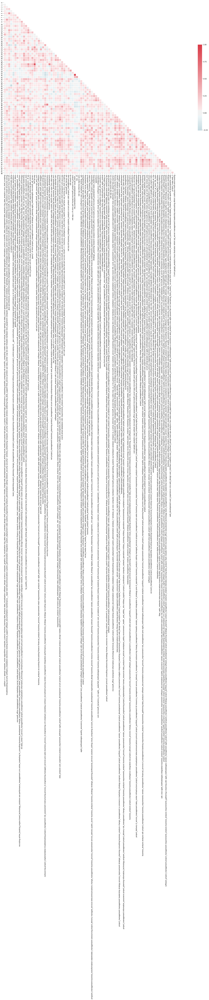

In [34]:
# Generate a mask for the upper triangle
mask = np.zeros_like(dfCos, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(50, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(dfCos, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

## Generación de Embeddings de Sentencia via Doc2Vec

In [74]:
#Infering sentences
def infer_doc2vec(model_name,jobs_labeled):
    model = model_name

    lbl=[]
    emb=[]
#     print(jobs_labeled)
    for job in jobs_labeled:
        model.random.seed(0)
#         print(job)
#         print(job[2])
        vecjob = model.infer_vector(doc_words=job)#, steps=20, alpha=0.025)
#         lbl.append(job[0:2])
        emb.append(vecjob)
    
    docs_emb = {"Labels": lbl
               ,"Embedding": np.array(emb)}
    
    return emb

In [75]:
fpath= os.getcwd()
fmodelname = os.path.join(fpath,'Model/Doc2vecForSkill.model')
model = Doc2Vec.load(fmodelname)

2019-02-13 12:53:31,917 : INFO : loading Doc2Vec object from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model
2019-02-13 12:53:31,952 : INFO : loading vocabulary recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.vocabulary.* with mmap=None
2019-02-13 12:53:31,953 : INFO : loading trainables recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.trainables.* with mmap=None
2019-02-13 12:53:31,954 : INFO : loading docvecs recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.docvecs.* with mmap=None
2019-02-13 12:53:31,954 : INFO : loading wv recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model.wv.* with mmap=None
2019-02-13 12:53:31,955 : INFO : loaded C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSkill.model


In [76]:
jobSenD2V=[]
for js in jobSentence:
#     print(js)
    eSenbyDes=infer_doc2vec(model,js[2])
    jobSenD2V.append([js[0],js[1],js[2],eSenbyDes])    
#     break;   

In [77]:
print(len(jobSenD2V))
print(len(jobSenD2V[16][2]))
# print(jobSenD2V[0][3])
# Save of list by sentence
pickle.dump(jobSenD2V, open( os.path.join(fprepath,"jobSkillD2V_sep.p"), "wb" ) )

293
34


In [78]:
pmD2V = []
for jse in jobSenD2V:
    if jse[0].find("project manager or equivalent")!= -1 and jse[0].find("senior project manager or equivalent")== -1:
        pmD2V.append(jse[0:4])

In [79]:
#Verify the total of sentences by job posititon
# c=0
sent2Vec=[]
for pms in pmD2V:
#     c=c+len(pms[2])
    for s in zip(pms[2],pms[3]):
        sent2Vec.append([" ".join(s[0]),s[1]])
#     break
print("Total number of sentences: {}".format(len(sent2Vec)))

Total number of sentences: 2076


In [80]:
#Cosine Similarity calculation
cosineMatS2V= np.zeros((len(sent2Vec),len(sent2Vec)))

#Validation
# for i,z in enumerate(sentEmb):
#     if i == 3:
#         break
#     print (z[0])
# print("#########################")

for x,s1 in enumerate(sent2Vec):
#     if x==3: break
    for y,s2 in enumerate(sent2Vec):
#         print(y)
#         if y==3: break
        sim= round(simil_cos(s1[1],s2[1]),4)
        cosineMatS2V[x][y]=sim
#         print("sentence 1:{}".format(s1[0]))
#         print("sentence 2:{}".format(s2[0]))
#         print("similarity:{}".format(sim))
#         print ("************\n")    

In [81]:
dfCosS2V = pd.DataFrame(cosineMatS2V,columns=[s[0] for s in sent2Vec])
dfCosS2V

,python,c++,opengl,computer_vision,algorithms,computer_science,machine_learning,data_analysis,data_visualization,software_design,...,illustrator,xhtml,sql_server,management,leadership,webcasting,dhtml,coldfusion,front-end,hosting
0,1.0000,0.2812,0.6449,0.6519,0.5472,0.4718,0.6458,0.5016,0.7221,0.3880,...,0.5888,0.5186,0.5016,0.5871,0.4821,0.4681,0.4391,0.4554,0.4829,0.4452
1,0.2812,1.0000,0.4714,0.4623,0.3668,0.4204,0.5471,0.5203,0.4217,0.7086,...,0.5262,0.4062,0.6735,0.2193,0.4807,0.3584,0.4364,0.3607,0.3671,0.3080
2,0.6449,0.4714,1.0000,0.8809,0.7187,0.6414,0.9364,0.4733,0.8471,0.7302,...,0.6655,0.6495,0.5568,0.5996,0.4872,0.5214,0.5318,0.4944,0.6302,0.5028
3,0.6519,0.4623,0.8809,1.0000,0.8624,0.7928,0.8192,0.4108,0.8882,0.8263,...,0.6751,0.7061,0.7820,0.5646,0.5907,0.6069,0.6387,0.5762,0.6138,0.5828
4,0.5472,0.3668,0.7187,0.8624,1.0000,0.9739,0.7461,0.2313,0.7177,0.8309,...,0.4948,0.8923,0.6469,0.5683,0.5774,0.5845,0.6229,0.5463,0.8497,0.5663
5,0.4718,0.4204,0.6414,0.7928,0.9739,1.0000,0.6481,0.3009,0.6305,0.8762,...,0.4224,0.8370,0.6657,0.5377,0.6139,0.5442,0.6298,0.5165,0.8365,0.5346
6,0.6458,0.5471,0.9364,0.8192,0.7461,0.6481,1.0000,0.3206,0.8005,0.6891,...,0.6850,0.7917,0.5172,0.5577,0.4314,0.5443,0.5182,0.5078,0.7334,0.5050
7,0.5016,0.5203,0.4733,0.4108,0.2313,0.3009,0.3206,1.0000,0.4321,0.5094,...,0.4797,0.1099,0.5004,0.6809,0.7487,0.2569,0.3651,0.2822,0.1847,0.2539
8,0.7221,0.4217,0.8471,0.8882,0.7177,0.6305,0.8005,0.4321,1.0000,0.6274,...,0.5287,0.5886,0.6124,0.4660,0.3778,0.4092,0.4632,0.3769,0.5925,0.3685
9,0.3880,0.7086,0.7302,0.8263,0.8309,0.8762,0.6891,0.5094,0.6274,1.0000,...,0.5472,0.6678,0.8039,0.5222,0.6853,0.5188,0.6488,0.5064,0.6423,0.5057


In [82]:
fprepath= os.path.join(fpath,"Preprocessing/")
dfCosS2V.to_csv(os.path.join(fprepath,"SimCosMatbySkill2Vec_sep.csv"))

In [ ]:
def save_tensorboard_proj(loc,dict_emb,lbl_file):
    LOG_DIR = os.path.join(os.getcwd(),loc)
    EMBEDDING_SIZE = len(dict_emb["Embedding"][0])
    VOCA_SIZE = len(dict_emb["Labels"])
    LABEL_FILE = os.path.join(os.getcwd(), os.path.join(loc,lbl_file))
    print("The current working directory:", LOG_DIR,"\n")
    print("the current LABEL_FILE:", LABEL_FILE, "\n")
    Labels=dict_emb["Labels"] 

    #Write label file 
    with open(LABEL_FILE,"w") as f:
        f.write("Generic Job Name\t Real Job Name \t Sencence\n")
        for i in range(VOCA_SIZE):
            f.write("{}\t{}\n".format(Labels[i][0].encode("utf-8"),Labels[i][1].encode("utf-8")))
                           
    print("{} file Created\n".format(lbl_file))
                        
    # word vector of embedding. 
    embedding_input = tf.Variable(dict_emb["Embedding"], dtype=tf.float32, name="input_embedding-no-label")

    # For input of Tensorboard Projector
    embeddings = tf.Variable(tf.zeros([VOCA_SIZE,EMBEDDING_SIZE], name="embedding_intial_tensor"), name="real_Embedding")
    assignment = embeddings.assign(embedding_input) 
    
    # To initilize the variable. 
    init = tf.global_variables_initializer()
    saver = tf.train.Saver()
    
    with tf.Session() as sess:
        sess.run(init)
        
        # Format: tensorflow/contrib/tensorboard/plugins/projector/projector_config.proto
        config = tf.contrib.tensorboard.plugins.projector.ProjectorConfig()
        # You can add multiple embeddings. Here we add only one.
        embedding_config = config.embeddings.add()
        embedding_config.tensor_name = embedding_input.name
        # Link this tensor to its metadata file (e.g. labels).
        embedding_config.metadata_path = LABEL_FILE
        
        # Use the same LOG_DIR where you stored your checkpoint.
        summary_writer = tf.summary.FileWriter(LOG_DIR)
    
        # The next line writes a projector_config.pbtxt in the LOG_DtenIR. TensorBoard will
        # read this file during startup.
        tf.contrib.tensorboard.plugins.projector.visualize_embeddings(summary_writer, config)
    
        save_path1 = saver.save(sess, os.path.join(LOG_DIR, "test_embedding_model.ckpt"), global_step=1)
        print("\nModel Saved in file: %s" % save_path1) 